In [22]:
import networkx as nx
import os
import matplotlib.pyplot as plt
import np as np
import pandas as pd
import plotly.graph_objects as go
from networkx import circular_layout

from linkmethods import filterlinks, get_links, get_views

In [2]:
article = 'Meisen'

In [3]:
path = fr'datafiles/{article}/backlinksdata'
cropped_result = [r[:-4] for r in os.listdir(path)]
print(cropped_result)

['Aegithalos', 'Alter Friedhof (Gießen)', 'Amsel', 'Apodaca Provincial Park', 'Appetenzverhalten', 'Arten des Anhangs I der Vogelschutzrichtlinie der EU', 'Bartkauz', 'Bartmeise', 'Baumhopfe', 'Bergkohlmeise', 'Beth Slikas', 'Beutelmeisen', 'Blaumeise', 'Blochinger Sandwinkel', 'Borodino-Buntmeise', 'Braunbürzelspecht', 'Brauner Bär (Schmetterling)', 'Buchsbaumzünsler', 'Buntmeise', 'Buntspecht', 'Burckhardtshöhe', 'Bylerward', 'Chibinen', 'Christopher M. Perrins', 'Cyanistes', 'Deutschland', 'Dommelspecht', 'Dunenspecht', 'Es rappelt im Karton', 'Europa- und Naturschutzgebiet Gerzkopf', 'Federsee', 'Fichtenmeise', 'Geographie der Vereinigten Staaten', 'Geographie Deutschlands', 'Gleispark Frintrop', 'Goldhähnchen-Laubsänger', 'Gordon Bay Provincial Park', 'Groß Zicker', 'Grüner Tropfenastrild', 'Gutshaus Friedenfelde', 'Handbook of the Birds of the World', 'Handschwinge', 'Hanko-Halbinsel', 'Hans Löhrl', 'Hartenstein (Mittelfranken)', 'Haubenmeise', 'Haussperling', 'Hellwinkel', 'Henr

In [4]:
flinks = []
for entry in cropped_result:
    try:
        flinks.append(filterlinks(get_links(entry,"links"))) #going through all forwardlinks and removing unreachable links
    except:
        print("Failed to pull data from:",entry)
        cropped_result.remove(entry)
        pass

In [5]:
df = pd.DataFrame(flinks,index=cropped_result).transpose()
df = df.fillna('Empty')
df

,Aegithalos,Alter Friedhof (Gießen),Amsel,Apodaca Provincial Park,Appetenzverhalten,Arten des Anhangs I der Vogelschutzrichtlinie der EU,Bartkauz,Bartmeise,Baumhopfe,Bergkohlmeise,...,Unglückshäher (Gattung),Usutu-Virus,Vogelnest,Vogelschutzgehölz Hausener Auwald,Vögel,Weichfresser,Weidenmeise,Wendehals (Vogel),Wintergoldhähnchen,Zweitbrut
0,Afghanistan,14. Jahrhundert,Aaskrähe,Amerikanischer Erdbeerbaum,Aversion,Adlerbussard,Adult,(8771) Biarmicus,Afrika,Art (Biologie),...,Adaptive Radiation,3'-Ende,Aaskrähe,Ahorn,Adler (Biologie),Allesfresser,Ahorne,(8773) Torquilla,Algerien,Brut
1,Beutelmeisen,19. Jahrhundert,Ablaut,BC Geographical Names,Begierde,Alkenvögel,Alaska,Adult,Baumhopf,Bhutan,...,Altgriechische Sprache,5'-Ende,Ammern,Altwasser (Fluss),Aerodynamik,Amsel,Art (Biologie),Adriatisches Meer,Art (Biologie),Drosseln
2,Brauenschwanzmeise,Alfred Bock (Schriftsteller),Adaptive Radiation,Biosphärenreservat,Endhandlung,Alpenkrähe,Allopatrisch,Art (Biologie),Baumhopfe (Gattung),Familie (Biologie),...,Bergkrähen,5′-Cap-Struktur,Antimikrobielle Substanzen,Asseln,Afrikanischer Strauß,Baumläufer,Baum,Akazien,Arven-Lärchenwald,Entenvögel
3,Burmaschwanzmeise,Altar,Adult,Bowen Island,Ethologie,Alpenschneehuhn,Amphibien,Asteroid,Baumläufer,Gattung (Biologie),...,Beringstraße,Aachen,Arides Klima,Baumläufer,Akkommodation (Auge),Bayerischer Rundfunk,Birken,Alaska,Aufplustern,Greifvogel
4,China,Alter jüdischer Friedhof (Gießen),Afghanistan,Bowen Island Ecological Reserve,Grzimeks Tierleben,Alpenstrandläufer,Anadyr (Fluss),Bartstreif,Bucerotiformes,Himalaya,...,Blauelster,Akronym,Beutelmeise,Brombeeren,Althochdeutsch,Beo,Bruchwälder,Ameisen,Avifauna Mitteleuropas,Konkurrenzdruck
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2216,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,...,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty
2217,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,...,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty
2218,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,...,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty
2219,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,...,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty,Empty


In [6]:
#amount of links per backlink (to get a lower runtime use a lower number)

In [7]:
cutoff = 2

In [8]:
#The Datafrane has much entrys with "None" thus im stopping the loop as the number of Backlinks from page runs out

In [9]:
rank = []
rows = []
for forward_links in cropped_result:
    print("Working on...",forward_links)
    for index,row in df[0:cutoff].iterrows():
        if(row[forward_links] == "Empty"):
            print("All backlins of",forward_links,"checked")
            break
        else:
            rank.append([forward_links,row[forward_links],sum(get_views(f"{row[forward_links]}"))])
            rows.append(row[forward_links])

Working on... Aegithalos
Working on... Alter Friedhof (Gießen)
Working on... Amsel
Working on... Apodaca Provincial Park
Working on... Appetenzverhalten
Working on... Arten des Anhangs I der Vogelschutzrichtlinie der EU
Working on... Bartkauz
Working on... Bartmeise
Working on... Baumhopfe
Working on... Bergkohlmeise
Working on... Beth Slikas
Working on... Beutelmeisen
No Data Availible for: Anthoscopus
Working on... Blaumeise
Working on... Blochinger Sandwinkel
Working on... Borodino-Buntmeise
Working on... Braunbürzelspecht
Working on... Brauner Bär (Schmetterling)
No Data Availible for: Arctia
Working on... Buchsbaumzünsler
Working on... Buntmeise
Working on... Buntspecht
Working on... Burckhardtshöhe
Working on... Bylerward
Working on... Chibinen
No Data Availible for: Aikuaiwentschorr
Working on... Christopher M. Perrins
Working on... Cyanistes
Working on... Deutschland
Working on... Dommelspecht
Working on... Dunenspecht
Working on... Es rappelt im Karton
Working on... Europa- un

In [10]:
blarticles = []
blviews = np.array([],dtype= int)
blnames = []
for i in rank:
    if((i[0] not in blarticles)):
        blarticles.append(i[0])
        blnames.append(i[1])
        blviews = np.append(blviews, i[2])
    else:
        blnames.append(i[1])
        blviews = np.append(blviews, i[2])

In [11]:
#getting a look at the gathered data and temporarily saving them

In [12]:
saved_df = pd.DataFrame(rank,columns=["main","Backlinksmain","views"])
sorted_pg = saved_df.sort_values(by=['views'],ascending=False)
sorted_pg

,main,Backlinksmain,views
141,Liebesinsel (Spree),Berlin,15317980
189,Liste Planegger Straßennamen,Albert Einstein,7795988
0,Aegithalos,Afghanistan,6957845
253,Schwanzmeisen,Afghanistan,6957845
62,Fichtenmeise,Afghanistan,6957845
...,...,...,...
117,Katy Trail State Park,Boonville (Missouri),0
120,Kleiner Schillerfalter,Apatura,0
300,Uebachtal,Am Kerstall,0
45,Chibinen,Aikuaiwentschorr,0


In [13]:
tuples = []
for entry in flinks:
    for e in entry[0:13]:
        if(entry[0] == e):
            pass
        else:
            tuples.append((entry[0],e))

In [14]:
tuples2 = []
track = []
for index, row in sorted_pg.iterrows():
    for e in row['main']:
        if(track.count(row['main'])>5):
            pass
        else:
            tuples2.append((row['main'],row['Backlinksmain']))

In [15]:
#adding the nodes and edges to the Graph

In [16]:
G = nx.Graph()
G.add_nodes_from(cropped_result)
flinkroutingp = []
for i in enumerate(flinks):
    flinkroutingp.append(i[1][0])
    G.add_node(i[1][0])
G.add_node(article)

In [17]:
G.add_edges_from([(r,article) for r in cropped_result])
G.add_edges_from([(r) for r in tuples2])

In [18]:
#Kamada Kawai layout

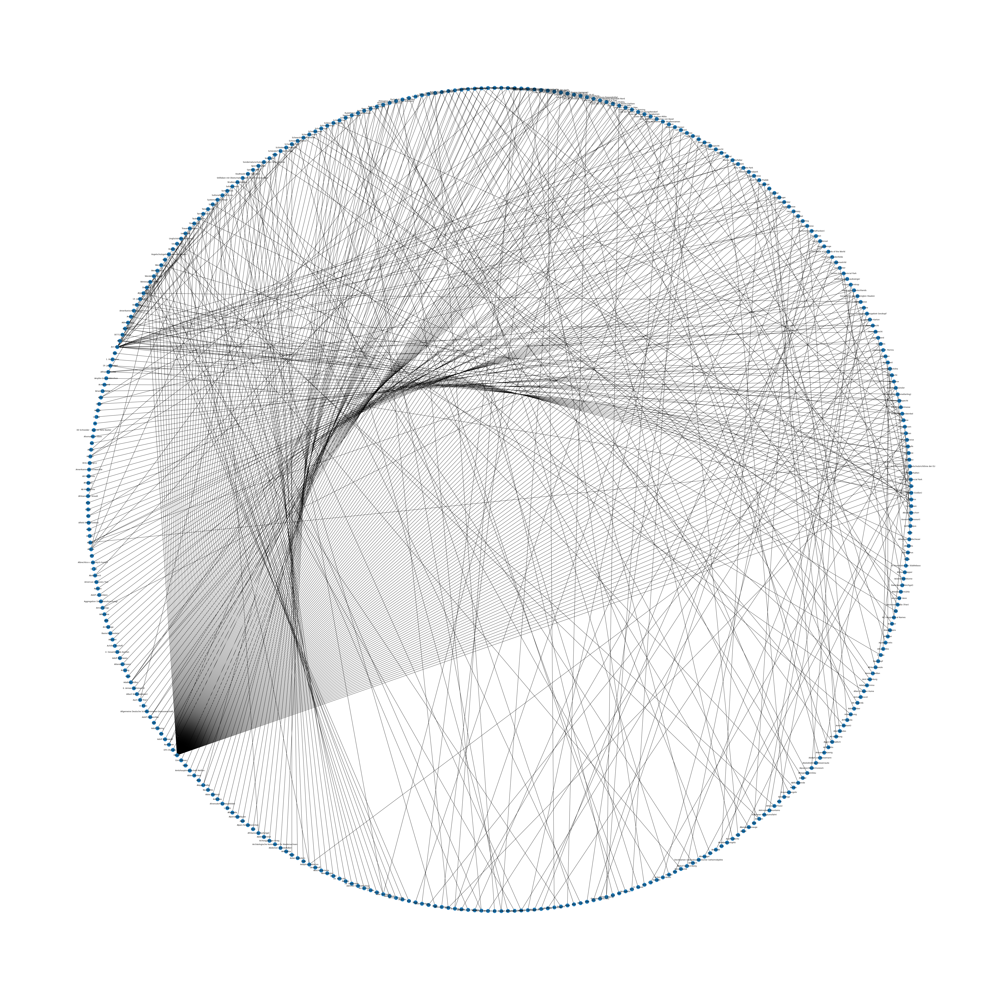

In [23]:
plt.rcParams["figure.figsize"] = (65,65)
nx.draw(G, with_labels=True, font_size=9, pos=circular_layout(G))
plt.savefig(f"Circularlayout from {article}.png",format="PNG")

In [ ]:
plt.rcParams["figure.figsize"] = (65,65)
nx.draw(G, with_labels=True, font_size=9, pos=nx.kamada_kawai_layout(G))
plt.savefig(f"Kamadakawailayout from {article}.png",format="PNG")

In [ ]:
#Spring layout graph

In [ ]:
plt.rcParams["figure.figsize"] = (60,60)
nx.spring_layout(G,k=0.15,iterations=10)
nx.draw(G, with_labels=True, node_size=1500, node_color="skyblue")
plt.savefig(f"Springlayout from {article}.png",format="PNG")

In [ ]:
from linkmethods import get_target, get_backlink_views
import numpy as np

In [ ]:
mean_views = list(np.array(get_backlink_views("Meisen", get_target("Meisen"))).mean(axis=1))

In [ ]:
source = [i for i in range(len(cropped_result))]
target = [len(source)]*len(source)
value = mean_views

In [ ]:
link = dict(source=source, target= target, value= value)
data = go.Sankey(link=link)
#fig = go.Figure(data)
fig = go.Figure(data=[go.Sankey(
    node= dict(
        pad = 15,
        thickness=15,
        label=cropped_result
    ),
    link= dict(
        source=source,
        target=target,
        value=value
    )
)])
fig.update_layout(title_text="", font_size=10, width=2000, height=2000)
fig.show()

In [ ]:
fig.write_html(r"C:\Users\Marvin\Desktop\sankey.html")